In [10]:
# !pip install imblearn ploty
!pip install imblearn

  Using cached imblearn-0.0-py2.py3-none-any.whl (1.9 kB)
     -------------------------------------- 226.0/226.0 kB 2.0 MB/s eta 0:00:00


In [2]:
# from google.colab import drive
# drive.mount('/content/drive/')

In [3]:
# path = '/content/drive/MyDrive/Analítica'
path = './'

In [8]:
# Librerias
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import OrdinalEncoder

In [11]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from pylab import rcParams
from imblearn.under_sampling import NearMiss
from imblearn.over_sampling import RandomOverSampler
from imblearn.combine import SMOTETomek
from imblearn.ensemble import BalancedBaggingClassifier
from collections import Counter
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay, cohen_kappa_score, f1_score, precision_recall_fscore_support
from sklearn.model_selection import cross_val_score
from sklearn.decomposition import PCA
import plotly.express as px
from tqdm import tqdm
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier

# Proyecto Final

 **Integrantes**:
- Román Pardo Alejandro
- Riubi Zuñiga Andrey
- Salazar Vega Rodrigo
- Verduzco Lozano Iván Antonio

El objetivo principal de este proyecto es 'Predecir los proveedores potencialmente fraudulentos' en función de las reclamaciones presentadas por ellos. También descubriremos cuáles son las variables más importantes que ayudan a detectar el comportamiento de proveedores potencialmente fraudulentos para que podamos señalar dichos reclamos y realizar una investigación profunda sobre ellos.

Los significados de algunas variables son:

#### 1. Inpatient and outpatient data:
- **ClaimID:** esta es una identificación única para cada reclamo enviado.
- **Bene_ID:** contiene la identificación única de los beneficiarios registrados para el plan de seguro.
- **AttendingPhysician:** columna que contiene el id de los médicos que atendieron al paciente.
- **OperatingPhysician:** la columna contiene la identificación de los médicos que operaron al paciente.
- **ClmDiagnosisCode:** contiene códigos de diagnóstico que los proveedores realizan en los pacientes.
- **ClmProcedureCode:** contiene códigos de procedimientos a los que se someten los pacientes.
- **Proveedor:** identificación única de los proveedores de atención médica.
- **InscClaimAmtReimbursed:** monto total pagado al reclamante después de la liquidación.
- **ClaimStartDt / ClaimEndDt:** estas columnas tienen la fecha en que se presentaron los reclamos y la fecha en que se liquidaron los reclamos, respectivamente.
- **AdmissionDt / HighDt:** Fecha en que el paciente ingresó en el hospital y la fecha en que el paciente fue dado de alta. Aplicable solo para datos de pacientes hospitalizados.

#### 2. Beneficiaries data:
- **Bene_ID:** contiene la identificación única de los beneficiarios registrados para el plan de seguro.
- **DOB:** Fecha de nacimiento de los beneficiarios registrados en el régimen de seguro.
- **Gender:** Género de los beneficiarios registrados en el régimen de seguro.
- **State/Country:** contiene el código de estado/país para los miembros registrados.
- **Premedical conditions:** hay algunas columnas como RenalDiseaseIndicator, ChronicCond_Depression, ChronicCond_Diabetes, etc. para indicar si el miembro tiene alguna condición médica previa.

#### 3. Target data:
- **Provider:** esta es una identificación única para cada uno de los proveedores de atención médica.
- **Target:** esta columna tiene dos valores, Sí y No, que indican si el proveedor correspondiente está marcado como fraude potencial o no.

In [12]:
# Load Train Dataset

Train=pd.read_csv(path + "/data proyecto/Train-1542865627584.csv")
Train_Beneficiarydata=pd.read_csv(path + "/data proyecto/Train_Beneficiarydata-1542865627584.csv")
Train_Inpatientdata=pd.read_csv(path + "/data proyecto/Train_Inpatientdata-1542865627584.csv")
Train_Outpatientdata=pd.read_csv(path + "/data proyecto/Train_Outpatientdata-1542865627584.csv")

In [13]:
Train_Inpatientdata

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ClmDiagnosisCode_7,ClmDiagnosisCode_8,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,2724,19889,5849,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,NaN,NaN,NaN,NaN,7092.0,NaN,NaN,NaN,NaN,NaN
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,BENE11011,CLM38412,2009-02-14,2009-02-22,PRV52405,5000,PHY369659,PHY392961,PHY349768,2009-02-14,...,25062,40390,4019,NaN,331.0,NaN,NaN,NaN,NaN,NaN
4,BENE11014,CLM63689,2009-08-13,2009-08-30,PRV56614,10000,PHY379376,PHY398258,NaN,2009-08-13,...,5119,29620,20300,NaN,3893.0,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40469,BENE159167,CLM69886,2009-09-28,2009-10-02,PRV53671,7000,PHY345332,PHY319565,NaN,2009-09-28,...,79092,70704,2869,4148,9904.0,NaN,NaN,NaN,NaN,NaN
40470,BENE159175,CLM74504,2009-11-03,2009-11-06,PRV54981,4000,PHY342806,PHY365497,NaN,2009-11-03,...,49122,4254,5990,NaN,8605.0,NaN,NaN,NaN,NaN,NaN
40471,BENE159177,CLM76485,2009-11-18,2009-11-22,PRV56588,3000,PHY423220,PHY332752,NaN,2009-11-18,...,71534,71590,V4502,NaN,9390.0,NaN,NaN,NaN,NaN,NaN
40472,BENE159177,CLM79949,2009-12-17,2009-12-18,PRV56575,5000,PHY353156,NaN,NaN,2009-12-17,...,4263,0414,41400,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [14]:
Train_Outpatientdata

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,ClmDiagnosisCode_1,...,ClmDiagnosisCode_9,ClmDiagnosisCode_10,ClmProcedureCode_1,ClmProcedureCode_2,ClmProcedureCode_3,ClmProcedureCode_4,ClmProcedureCode_5,ClmProcedureCode_6,DeductibleAmtPaid,ClmAdmitDiagnosisCode
0,BENE11002,CLM624349,2009-10-11,2009-10-11,PRV56011,30,PHY326117,NaN,NaN,78943,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,56409
1,BENE11003,CLM189947,2009-02-12,2009-02-12,PRV57610,80,PHY362868,NaN,NaN,6115,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,79380
2,BENE11003,CLM438021,2009-06-27,2009-06-27,PRV57595,10,PHY328821,NaN,NaN,2723,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
3,BENE11004,CLM121801,2009-01-06,2009-01-06,PRV56011,40,PHY334319,NaN,NaN,71988,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
4,BENE11004,CLM150998,2009-01-22,2009-01-22,PRV56011,200,PHY403831,NaN,NaN,82382,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,71947
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
517732,BENE159198,CLM510792,2009-08-06,2009-08-06,PRV53699,800,PHY364188,PHY364188,PHY385752,2163,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
517733,BENE159198,CLM551294,2009-08-29,2009-08-29,PRV53702,400,PHY423019,PHY332284,NaN,07041,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
517734,BENE159198,CLM596444,2009-09-24,2009-09-24,PRV53676,60,PHY361063,NaN,NaN,V570,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
517735,BENE159198,CLM636992,2009-10-18,2009-10-18,PRV53689,70,PHY403198,NaN,PHY419379,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN


In [15]:
Train_Beneficiarydata

,BeneID,DOB,DOD,Gender,Race,RenalDiseaseIndicator,State,County,NoOfMonths_PartACov,NoOfMonths_PartBCov,...,ChronicCond_Depression,ChronicCond_Diabetes,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt
0,BENE11001,1943-01-01,NaN,1,1,0,39,230,12,12,...,1,1,1,2,1,1,36000,3204,60,70
1,BENE11002,1936-09-01,NaN,2,1,0,39,280,12,12,...,2,2,2,2,2,2,0,0,30,50
2,BENE11003,1936-08-01,NaN,1,1,0,52,590,12,12,...,2,2,1,2,2,2,0,0,90,40
3,BENE11004,1922-07-01,NaN,1,1,0,39,270,12,12,...,2,1,1,1,1,2,0,0,1810,760
4,BENE11005,1935-09-01,NaN,1,1,0,24,680,12,12,...,2,1,2,2,2,2,0,0,1790,1200
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138551,BENE159194,1939-07-01,NaN,1,1,0,39,140,12,12,...,2,2,2,2,2,2,0,0,430,460
138552,BENE159195,1938-12-01,NaN,2,1,0,49,530,12,12,...,2,1,2,2,2,2,0,0,880,100
138553,BENE159196,1916-06-01,NaN,2,1,0,6,150,12,12,...,1,1,1,2,2,2,2000,1068,3240,1390
138554,BENE159197,1930-01-01,NaN,1,1,0,16,560,12,12,...,2,2,1,2,2,2,0,0,2650,10


In [16]:
Train

,Provider,PotentialFraud
0,PRV51001,No
1,PRV51003,Yes
2,PRV51004,No
3,PRV51005,Yes
4,PRV51007,No
...,...,...
5405,PRV57759,No
5406,PRV57760,No
5407,PRV57761,No
5408,PRV57762,No


In [17]:
unique_ben_inpat = Train_Inpatientdata['BeneID'].unique()
unique_ben_outpat = Train_Outpatientdata['BeneID'].unique()
valores_comunes = set(unique_ben_inpat) & set(unique_ben_outpat)
valores_comunes_lista = list(valores_comunes)

In [18]:
len(Train_Beneficiarydata['BeneID'].unique())

138556

In [19]:
len(unique_ben_inpat)

31289

In [20]:
len(valores_comunes_lista)

26713

In [21]:
len(unique_ben_outpat)

133980

Text(0, 0.5, 'Frecuencia')

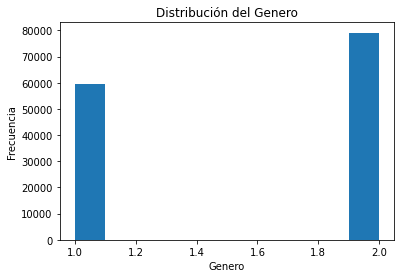

In [22]:
plt.hist(Train_Beneficiarydata['Gender'])
plt.title('Distribución del Genero')
plt.xlabel('Genero')
plt.ylabel('Frecuencia')

In [23]:
#Establecemos las calumnas con datos de tiempo en formato de fecha
Train_Beneficiarydata['DOD'] = pd.to_datetime(Train_Beneficiarydata['DOD'])
Train_Beneficiarydata['DOB'] = pd.to_datetime(Train_Beneficiarydata['DOB'])

Train_Outpatientdata['ClaimStartDt'] = pd.to_datetime(Train_Outpatientdata['ClaimStartDt'])
Train_Outpatientdata['ClaimEndDt'] = pd.to_datetime(Train_Outpatientdata['ClaimEndDt'])

Train_Inpatientdata['ClaimStartDt'] = pd.to_datetime(Train_Inpatientdata['ClaimStartDt'])
Train_Inpatientdata['ClaimEndDt'] = pd.to_datetime(Train_Inpatientdata['ClaimEndDt'])

In [24]:
#Calculamos le edad de los beneficiarios, tomando en cuenta la fecha del fallecimiento más reciente
t_dod = Train_Beneficiarydata['DOD'].unique()
t_dod = [x for x in t_dod if pd.isnull(x) == False]
dod_max = max(t_dod)
Train_Beneficiarydata['DOD'].fillna(dod_max, inplace=True)
Train_Beneficiarydata['Age'] = np.round(((Train_Beneficiarydata['DOD'] - Train_Beneficiarydata['DOB']).dt.days)/365.0,0)

#Agregamos una columna para la duración de la reclamación
Train_Inpatientdata['CDT'] = (Train_Inpatientdata['ClaimEndDt'] - Train_Inpatientdata['ClaimStartDt']).dt.days
Train_Outpatientdata['CDT'] = (Train_Outpatientdata['ClaimEndDt'] - Train_Outpatientdata['ClaimStartDt']).dt.days

In [25]:
#Agregamos una columna que indique si es ingresado o no
Train_Inpatientdata['is_inpatient'] = 1
Train_Outpatientdata['is_inpatient'] = 0

#Unimos los datos de Pacientes In y Out
Train_hd = pd.concat([Train_Inpatientdata, Train_Outpatientdata], axis=0, ignore_index=True)

#Juntamos los datos del beneficiario y del provedor para fomrar el dataset a utilizar
Train_hd = pd.merge(Train_hd, Train_Beneficiarydata, on='BeneID')
Train_hd = pd.merge(Train_hd, Train[['Provider', 'PotentialFraud']], on='Provider', how='left')

In [26]:
Train_hd

,BeneID,ClaimID,ClaimStartDt,ClaimEndDt,Provider,InscClaimAmtReimbursed,AttendingPhysician,OperatingPhysician,OtherPhysician,AdmissionDt,...,ChronicCond_IschemicHeart,ChronicCond_Osteoporasis,ChronicCond_rheumatoidarthritis,ChronicCond_stroke,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age,PotentialFraud
0,BENE11001,CLM46614,2009-04-12,2009-04-18,PRV55912,26000,PHY390922,NaN,NaN,2009-04-12,...,1,2,1,1,36000,3204,60,70,67.0,Yes
1,BENE11001,CLM66048,2009-08-31,2009-09-02,PRV55907,5000,PHY318495,PHY318495,NaN,2009-08-31,...,1,2,1,1,36000,3204,60,70,67.0,No
2,BENE11001,CLM68358,2009-09-17,2009-09-20,PRV56046,5000,PHY372395,NaN,PHY324689,2009-09-17,...,1,2,1,1,36000,3204,60,70,67.0,No
3,BENE11011,CLM38412,2009-02-14,2009-02-22,PRV52405,5000,PHY369659,PHY392961,PHY349768,2009-02-14,...,2,2,1,1,5000,1068,250,320,96.0,No
4,BENE11011,CLM144521,2009-01-18,2009-01-18,PRV52314,50,PHY379398,NaN,NaN,NaN,...,2,2,1,1,5000,1068,250,320,96.0,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
558206,BENE159198,CLM510792,2009-08-06,2009-08-06,PRV53699,800,PHY364188,PHY364188,PHY385752,NaN,...,2,2,1,2,0,0,5470,1870,58.0,No
558207,BENE159198,CLM551294,2009-08-29,2009-08-29,PRV53702,400,PHY423019,PHY332284,NaN,NaN,...,2,2,1,2,0,0,5470,1870,58.0,No
558208,BENE159198,CLM596444,2009-09-24,2009-09-24,PRV53676,60,PHY361063,NaN,NaN,NaN,...,2,2,1,2,0,0,5470,1870,58.0,No
558209,BENE159198,CLM636992,2009-10-18,2009-10-18,PRV53689,70,PHY403198,NaN,PHY419379,NaN,...,2,2,1,2,0,0,5470,1870,58.0,No


(array([212796.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,      0., 345415.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

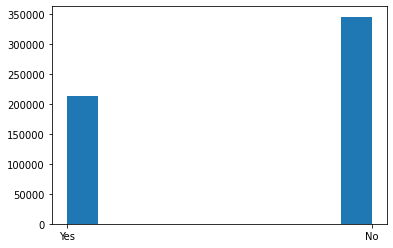

In [27]:
plt.hist(Train_hd.query('AttendingPhysician != "nan"')['PotentialFraud'])

(array([212796.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,      0., 345415.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

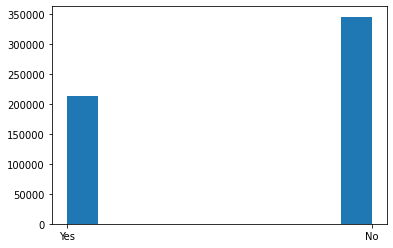

In [28]:
plt.hist(Train_hd.query('OperatingPhysician != "nan"')['PotentialFraud'])

Text(0, 0.5, 'Frecuencia')

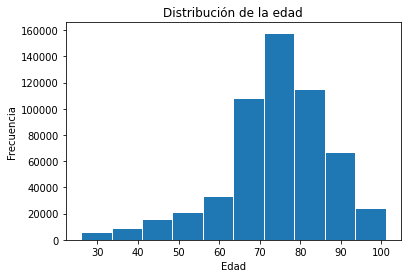

In [29]:
plt.hist(Train_hd.Age, edgecolor = 'white')
plt.title('Distribución de la edad')
plt.xlabel('Edad')
plt.ylabel('Frecuencia')

In [30]:
Train_hd.isnull().sum()

BeneID                                  0
ClaimID                                 0
ClaimStartDt                            0
ClaimEndDt                              0
Provider                                0
InscClaimAmtReimbursed                  0
AttendingPhysician                   1508
OperatingPhysician                 443764
OtherPhysician                     358475
AdmissionDt                        517737
ClmAdmitDiagnosisCode              412312
DeductibleAmtPaid                     899
DischargeDt                        517737
DiagnosisGroupCode                 517737
ClmDiagnosisCode_1                  10453
ClmDiagnosisCode_2                 195606
ClmDiagnosisCode_3                 315156
ClmDiagnosisCode_4                 393675
ClmDiagnosisCode_5                 446287
ClmDiagnosisCode_6                 473819
ClmDiagnosisCode_7                 492034
ClmDiagnosisCode_8                 504767
ClmDiagnosisCode_9                 516396
ClmDiagnosisCode_10               

In [31]:
#Realizamos diferencia entre el deducible y el reembolsable
#Non-Hospitalization Reimbursement Deductible difference (NH_DMR)
#Hospitalization Reimbursement Deductible difference (H_DMR)

Train_hd2 = Train_hd

#Sustitutendo nulos con la moda
Train_hd2['DeductibleAmtPaid'].fillna(0, inplace=True)

#Agregamos columna con la diferencia entre lo deducible y lo reembolsable
Train_hd2['DRD'] = Train_hd2['InscClaimAmtReimbursed'] - Train_hd2['DeductibleAmtPaid']
#Train_hd2['NH_DRD'] = Train_hd2['IPAnnualReimbursementAmt'] - Train_hd2['IPAnnualDeductibleAmt']
#Train_hd2['H_DRD'] = Train_hd2['OPAnnualReimbursementAmt'] - Train_hd2['OPAnnualDeductibleAmt']

#Cuantifica los códigos de procedimeintos
Train_hd2['ClmProcedureCode_count'] = Train_hd2['ClmProcedureCode_1'].notnull().astype(int) + Train_hd2['ClmProcedureCode_2'].notnull().astype(int) + Train_hd2['ClmProcedureCode_3'].notnull().astype(int) + Train_hd2['ClmProcedureCode_4'].notnull().astype(int) + Train_hd2['ClmProcedureCode_5'].notnull().astype(int) + Train_hd2['ClmProcedureCode_6'].notnull().astype(int)
Train_hd2.drop(['ClmProcedureCode_1', 'ClmProcedureCode_2', 'ClmProcedureCode_3', 'ClmProcedureCode_4', 'ClmProcedureCode_5', 'ClmProcedureCode_6'], axis=1, inplace=True)

#Cuantifica el número de códigos de diagnosticos
Train_hd2['Diagnosis_count'] = Train_hd2['ClmDiagnosisCode_1'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_2'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_3'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_4'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_5'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_6'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_7'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_8'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_9'].notnull().astype(int) + Train_hd2['ClmDiagnosisCode_10'].notnull().astype(int)
Train_hd2.drop(['ClmDiagnosisCode_1', 'ClmDiagnosisCode_2', 'ClmDiagnosisCode_3', 'ClmDiagnosisCode_4', 'ClmDiagnosisCode_5', 'ClmDiagnosisCode_6', 'ClmDiagnosisCode_7', 'ClmDiagnosisCode_8', 'ClmDiagnosisCode_9', 'ClmDiagnosisCode_10'], axis=1, inplace=True)

#Agregamos una columna que indique si el paciente sufrió un operación
Train_hd2['Operating'] = Train_hd2['OperatingPhysician'].apply(lambda val: 0 if val != val else 1)

#Modificar al codificación de la columna de enfermefdad renal
Train_hd2['RenalDiseaseIndicator'] = Train_hd2['RenalDiseaseIndicator'].apply(lambda val: 0 if val != "Y" else 1).values

(array([1.99272e+05, 0.00000e+00, 1.02780e+04, 0.00000e+00, 2.68300e+03,
        0.00000e+00, 4.87000e+02, 0.00000e+00, 7.00000e+01, 6.00000e+00]),
 array([0. , 0.5, 1. , 1.5, 2. , 2.5, 3. , 3.5, 4. , 4.5, 5. ]),
 <BarContainer object of 10 artists>)

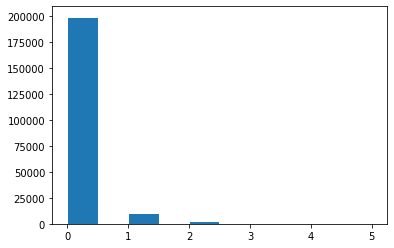

In [32]:
plt.hist(Train_hd2.query('PotentialFraud == "Yes"')['ClmProcedureCode_count'], edgecolor = 'white')

(array([2.07412e+05, 3.66700e+03, 9.36000e+02, 3.50000e+02, 3.58000e+02,
        2.00000e+01, 1.90000e+01, 1.40000e+01, 1.00000e+01, 1.00000e+01]),
 array([ -1068. ,  11438.8,  23945.6,  36452.4,  48959.2,  61466. ,
         73972.8,  86479.6,  98986.4, 111493.2, 124000. ]),
 <BarContainer object of 10 artists>)

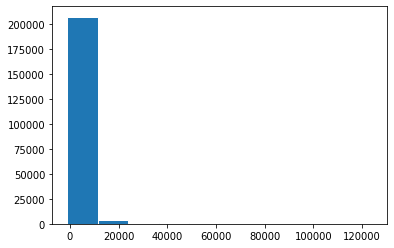

In [33]:
plt.hist(Train_hd2.query('PotentialFraud == "Yes"')['DRD'], edgecolor = 'white')

In [34]:
#Eliminamos columnas con formato de fecha
Train_hd2 = Train_hd2.drop(['ClaimStartDt', 'ClaimEndDt', 'DOB', 'DOD',
                            'AdmissionDt', 'DischargeDt'], axis = 1)

#Eliminamos columnas que no aportan información
Train_hd2 = Train_hd2.drop(['BeneID', 'ClaimID', 'NoOfMonths_PartACov', 'NoOfMonths_PartBCov',
    'AttendingPhysician','OperatingPhysician', 'OtherPhysician', 'ClmAdmitDiagnosisCode', 'DiagnosisGroupCode'], axis = 1)


In [35]:
# Convert to numeric the provider ID
Train_hd2['Provider'] = Train_hd2['Provider'].apply(lambda x: x.split('PRV')[1]).astype(int)

In [36]:
Train_hd2.isnull().sum()

Provider                           0
InscClaimAmtReimbursed             0
DeductibleAmtPaid                  0
CDT                                0
is_inpatient                       0
Gender                             0
Race                               0
RenalDiseaseIndicator              0
State                              0
County                             0
ChronicCond_Alzheimer              0
ChronicCond_Heartfailure           0
ChronicCond_KidneyDisease          0
ChronicCond_Cancer                 0
ChronicCond_ObstrPulmonary         0
ChronicCond_Depression             0
ChronicCond_Diabetes               0
ChronicCond_IschemicHeart          0
ChronicCond_Osteoporasis           0
ChronicCond_rheumatoidarthritis    0
ChronicCond_stroke                 0
IPAnnualReimbursementAmt           0
IPAnnualDeductibleAmt              0
OPAnnualReimbursementAmt           0
OPAnnualDeductibleAmt              0
Age                                0
PotentialFraud                     0
D

In [37]:
Train_hd2

,Provider,InscClaimAmtReimbursed,DeductibleAmtPaid,CDT,is_inpatient,Gender,Race,RenalDiseaseIndicator,State,County,...,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age,PotentialFraud,DRD,ClmProcedureCode_count,Diagnosis_count,Operating
0,55912,26000,1068.0,6,1,1,1,0,39,230,...,36000,3204,60,70,67.0,Yes,24932.0,0,9,0
1,55907,5000,1068.0,2,1,1,1,0,39,230,...,36000,3204,60,70,67.0,No,3932.0,1,3,1
2,56046,5000,1068.0,3,1,1,1,0,39,230,...,36000,3204,60,70,67.0,No,3932.0,0,6,0
3,52405,5000,1068.0,8,1,2,2,0,1,360,...,5000,1068,250,320,96.0,No,3932.0,1,9,1
4,52314,50,0.0,0,0,2,2,0,1,360,...,5000,1068,250,320,96.0,No,50.0,0,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
558206,53699,800,0.0,0,0,2,1,0,21,20,...,0,0,5470,1870,58.0,No,800.0,0,3,1
558207,53702,400,0.0,0,0,2,1,0,21,20,...,0,0,5470,1870,58.0,No,400.0,0,3,1
558208,53676,60,0.0,0,0,2,1,0,21,20,...,0,0,5470,1870,58.0,No,60.0,0,2,0
558209,53689,70,0.0,0,0,2,1,0,21,20,...,0,0,5470,1870,58.0,No,70.0,0,0,0


In [38]:
sc = MinMaxScaler()
X = Train_hd2.drop(['PotentialFraud'], axis = 1).values
Y = Train_hd2['PotentialFraud'].apply(lambda val: 0 if val != "Yes" else 1).values

In [39]:
X_train, X_test, y_train, y_test = train_test_split(
                                                    X,
                                                    Y,
                                                    test_size=0.3,
                                                    shuffle = True,
                                                    random_state = 137,
                                                    stratify = Y
                                                    )

X_train_s = sc.fit_transform(X_train)
X_test_s = sc.transform(X_test)

# X_train_s and X_test_s to DataFrame
# Get columns without target
columns = Train_hd2.columns
columns = columns.drop('PotentialFraud')
X_train_s = pd.DataFrame(X_train_s, columns = columns)
X_test_s = pd.DataFrame(X_test_s, columns = columns)

In [40]:
X_train_aux = np.concatenate((X_train_s, y_train.reshape(-1, 1)), axis = 1)
X_train_aux = pd.DataFrame(X_train_aux, columns = Train_hd2.columns)
X_train_aux.head()

,Provider,InscClaimAmtReimbursed,DeductibleAmtPaid,CDT,is_inpatient,Gender,Race,RenalDiseaseIndicator,State,County,...,IPAnnualReimbursementAmt,IPAnnualDeductibleAmt,OPAnnualReimbursementAmt,OPAnnualDeductibleAmt,Age,PotentialFraud,DRD,ClmProcedureCode_count,Diagnosis_count,Operating
0,0.938628,0.00240,0.0,0.000000,0.0,0.0,0.0,0.0,0.226415,0.340340,...,0.047206,0.000000,0.010385,0.016618,0.453333,0.010938,0.0,0.1,0.0,0.0
1,0.559746,0.00080,0.0,0.027778,0.0,1.0,0.0,0.0,0.566038,0.270270,...,0.047206,0.000000,0.006309,0.019509,0.440000,0.009339,0.0,0.3,0.0,1.0
2,0.557675,0.00056,0.0,0.000000,0.0,1.0,0.0,0.0,0.566038,0.000000,...,0.047206,0.000000,0.001747,0.000000,0.800000,0.009099,0.0,0.1,0.0,1.0
3,0.427093,0.00032,0.0,0.000000,0.0,1.0,0.0,1.0,0.415094,0.570571,...,0.106213,0.055811,0.001068,0.001445,0.546667,0.008859,0.0,0.2,0.0,0.0
4,0.164596,0.00048,0.0,0.000000,0.0,1.0,0.0,1.0,0.169811,0.500501,...,0.047206,0.000000,0.004659,0.002890,0.840000,0.009019,0.0,0.2,0.0,1.0


In [41]:
# corr = X_train_aux.corr()
# corr_x.abs().unstack().drop_duplicates().sort_values(ascending=False)
# corr_target = abs(corr['PotentialFraud'])
# relevant_features = corr_target[corr_target > 0.05]
# relevant_features
print(X_train_aux.shape)
corr_x = X_train_aux.corr(method='pearson')
print(corr_x.style.background_gradient (cmap = 'coolwarm'))


# eliminar las columnas con alta correlación entre ellas
# Creamos una matriz triangular superior con valores booleanos
mask = np.triu(np.ones_like(corr_x, dtype=bool))

corr_x_masked = corr_x.mask(mask)

columns_to_drop = [column for column in corr_x_masked.columns if any(corr_x_masked[column] > 0.8)]

corr_x.drop(columns_to_drop, inplace=True)
corr_target = abs(corr_x['PotentialFraud'])
relevant_features = corr_target[corr_target > 0.05]
print(relevant_features.shape, '\n', relevant_features)

(390747, 31)
(14,) 
 CDT                           0.252443
is_inpatient                  0.624299
RenalDiseaseIndicator         0.058729
ChronicCond_Heartfailure      0.055282
ChronicCond_KidneyDisease     0.094160
ChronicCond_ObstrPulmonary    0.065152
ChronicCond_IschemicHeart     0.050154
IPAnnualReimbursementAmt      0.379225
IPAnnualDeductibleAmt         0.212126
PotentialFraud                1.000000
DRD                           0.606518
ClmProcedureCode_count        0.396886
Diagnosis_count               0.251957
Operating                     0.076724
Name: PotentialFraud, dtype: float64


In [42]:
# Get columns of revelevant features
relevant_features = list(relevant_features.index)
# relevant_features except PotentialFraud
relevant_features.remove('PotentialFraud')
relevant_features.append('Provider')
relevant_features

['CDT',
 'is_inpatient',
 'RenalDiseaseIndicator',
 'ChronicCond_Heartfailure',
 'ChronicCond_KidneyDisease',
 'ChronicCond_ObstrPulmonary',
 'ChronicCond_IschemicHeart',
 'IPAnnualReimbursementAmt',
 'IPAnnualDeductibleAmt',
 'DRD',
 'ClmProcedureCode_count',
 'Diagnosis_count',
 'Operating',
 'Provider']

In [43]:
# Get columns of irrelevant features
irrelevant_features = list(set(columns) - set(relevant_features))
irrelevant_features

['County',
 'OPAnnualReimbursementAmt',
 'State',
 'ChronicCond_Cancer',
 'Race',
 'OPAnnualDeductibleAmt',
 'InscClaimAmtReimbursed',
 'ChronicCond_rheumatoidarthritis',
 'Age',
 'ChronicCond_stroke',
 'ChronicCond_Alzheimer',
 'ChronicCond_Osteoporasis',
 'Gender',
 'DeductibleAmtPaid',
 'ChronicCond_Diabetes',
 'ChronicCond_Depression']

<function matplotlib.pyplot.show(close=None, block=None)>

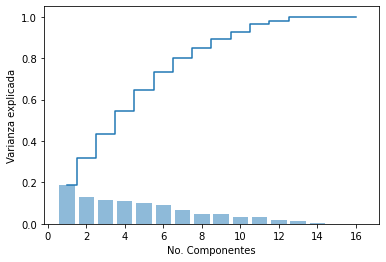

In [44]:
mat_cov = np.cov(X_train_s[irrelevant_features].T)
eig_val, eig_vec = np.linalg.eig(mat_cov)
var_exp = [(i / sum(eig_val)) for i in sorted(eig_val, reverse = True)]
var_exp_cum = np.cumsum(var_exp)

plt.bar(range(1, len(eig_val) + 1), var_exp, alpha = 0.5, align = 'center')
plt.step(range(1, len(eig_val) + 1), var_exp_cum, where = 'mid')
plt.xlabel('No. Componentes')
plt.ylabel('Varianza explicada')
plt.show

In [45]:
pca = PCA(n_components=7)
components = pca.fit_transform(X_train_s[irrelevant_features])
components_test = pca.transform(X_test_s[irrelevant_features])

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=y_train,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

In [46]:
# X_train_filtered
X_train_filtered = X_train_s[relevant_features]
X_test_filtered = X_test_s[relevant_features]
X_train_filtered.columns

Index(['CDT', 'is_inpatient', 'RenalDiseaseIndicator',
       'ChronicCond_Heartfailure', 'ChronicCond_KidneyDisease',
       'ChronicCond_ObstrPulmonary', 'ChronicCond_IschemicHeart',
       'IPAnnualReimbursementAmt', 'IPAnnualDeductibleAmt', 'DRD',
       'ClmProcedureCode_count', 'Diagnosis_count', 'Operating', 'Provider'],
      dtype='object')

In [47]:
# Concatenamos las columnas numéricas con las columnas nominales transformadas
train_nom = pd.DataFrame(components, columns = [str(x) for x in range(0,7)])
test_nom = pd.DataFrame(components_test, columns = [str(x) for x in range(0,7)])

X_train_filtered = pd.concat([X_train_s, train_nom], axis=1)
X_test_filtered = pd.concat([X_test_s, test_nom], axis=1)

In [57]:
def metricas(real, predict):
    # Calculo de sensitivity y specificity
    res = list()
    prec,recall,_,_ = precision_recall_fscore_support(real,
                                                      predict,
                                                      pos_label=True,average=None)

    fpr, tpr, thresholds = metrics.roc_curve(real, predict, pos_label=1)
    auc = metrics.auc(fpr, tpr)
    # res.append([recall[0],recall[1],accuracy_score(real,predict),cohen_kappa_score(real, predict),auc, f1_score(real, predict)])
    # resumen = pd.DataFrame(res,columns = ['sensitivity','specificity', 'Accuracy val', 'Kappa Value:', 'Auc', 'F1_score:'])
    print('Valor de Sensitivity: ', recall[0])
    print('Valor de Specificity: ', recall[1])
    print('Valor de Accuracy: ', accuracy_score(real,predict))    
    print('Valor de Kappa: ', cohen_kappa_score(real, predict))
    print('Valor de AUC: ', auc)
    print('Valor de F1:', f1_score(real, predict))
    # print(resumen)
    # display confusion_matrix
    # fig, ax = plt.subplots(ncols=1, figsize=(6,8))
    cm = confusion_matrix(real, predict, labels=np.unique(real))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=np.unique(real))
    disp.plot()

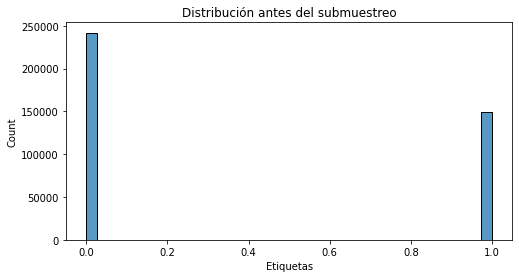

In [49]:
fig, ax = plt.subplots(nrows=1, figsize=(8, 4))
sns.histplot(y_train, ax=ax)
plt.title('Distribución antes del submuestreo')
_ = plt.xlabel('Etiquetas')

In [50]:
# Codigo del submuestreo
nm = NearMiss(version= 1, n_neighbors=5)
X_train_sub, y_train_sub = nm.fit_resample(X_train_filtered, y_train)
X_test_sub, y_test_sub = nm.fit_resample(X_test_filtered, y_test)

print('Antes del submuestreo de y: ', Counter(y_train))
print('Muestras submuestradas de y: ', Counter(y_train_sub))

print(type(y_test_sub))
print('Antes del submuestreo de test: ', Counter(y_test))
print('Despues del submuestreo de test: ', Counter(y_test_sub))
# print('Muestras submuestradas de test: ', Counter(X_test_sub))

Antes del submuestreo de y:  Counter({0: 241790, 1: 148957})
Muestras submuestradas de y:  Counter({0: 148957, 1: 148957})
<class 'numpy.ndarray'>
Antes del submuestreo de test:  Counter({0: 103625, 1: 63839})
Despues del submuestreo de test:  Counter({0: 63839, 1: 63839})


In [51]:
# Del X_train, sacamos conjunto de validación
X_train, X_val, y_train, y_val = train_test_split(X_train_sub,
                                                    y_train_sub,
                                                    test_size=0.2,
                                                    shuffle = True,
                                                    random_state = 137,
                                                    stratify = y_train_sub
                                                    )

In [52]:
# Cross validation
def cross_val(model, X_train, y_train, cv):
    scores = cross_val_score(model, X_train, y_train, cv=cv, scoring='accuracy')
    return np.mean(scores)

  0%|          | 0/13 [00:00<?, ?it/s]

100%|██████████| 13/13 [05:42<00:00, 26.32s/it]


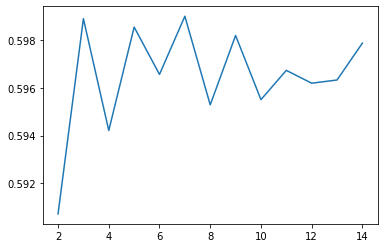

In [53]:
# Buscando el mejor k con cross validation
rango = range(2, 15)
scores = []

for k in tqdm(rango):
    knn = KNeighborsClassifier(n_neighbors=k)
    scores.append(cross_val(knn, X_val, y_val, 8))

plt.plot(rango, scores)

In [54]:
# Knn
knn = KNeighborsClassifier(n_neighbors = 7)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test_sub)
metricas(y_test_sub, y_pred)
print('Cross Validation:', cross_val(knn, X_val, y_val, 8))

Valor de Sensitivity:  0.7345039865912687


NameError: name 'revall' is not defined

In [1]:
metricas(y_testsub, y_pred)

NameError: name 'metricas' is not defined

100%|██████████| 4/4 [12:01<00:00, 180.35s/it]


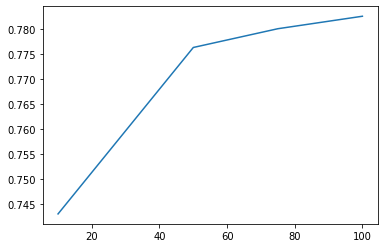

In [59]:
# Buscando los mejores estimadores random forest
estimators = [10, 50, 75, 100]
scores = []

for e in tqdm(estimators):
    rf = RandomForestClassifier(n_estimators=e, random_state=137)
    scores.append(cross_val(rf, X_val, y_val, 5))

plt.plot(estimators, scores)

Valor de Sensitivity:  0.8547283008819061
Valor de Specificity:  0.8391892103573051
Valor de Accuracy:  0.8469587556196055
Valor de Kappa:  0.6939175112392111
Valor de AUC:  0.8469587556196055
Valor de F1: 0.8457603839413984


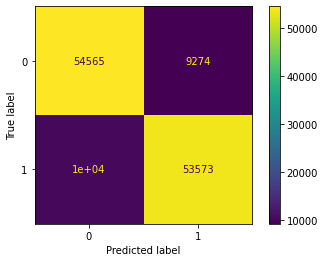

In [60]:
clf = RandomForestClassifier(n_estimators=90)
clf.fit(X_train, y_train)
prediccion = clf.predict(X_test_sub)

metricas(y_test_sub, prediccion)

In [62]:
cross_val(clf, X_val, y_val, 8)

0.7863989125011881

Valor de Sensitivity:  0.7370259559203621
Valor de Specificity:  0.5285640439229938
Valor de Accuracy:  0.632794999921678
Valor de Kappa:  0.26558999984335596
Valor de AUC:  0.6327949999216781
Valor de F1: 0.5900673253475562
Cross Validation:  0.6360539932924784


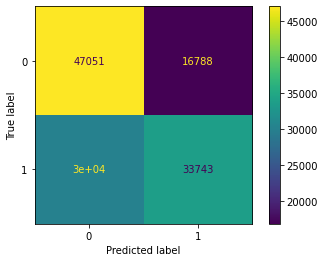

In [66]:
# Cross validation con Regresión Logística
lr = LogisticRegression(random_state=137, max_iter=1000)
lr.fit(X_train, y_train)
y_pred_log = lr.predict(X_test_sub)
metricas(y_test_sub, y_pred_log)
scores = cross_val_score(lr, X_val, y_val, cv=5, scoring='accuracy')
print('Cross Validation: ', np.mean(scores))

In [67]:
# Cross validation con Multi Layer Perceptron
solvers = ['sgd', 'adam']

for s in tqdm(solvers):
    mlp = MLPClassifier(solver=s, random_state=137, max_iter=1000, activation='relu', shuffle=False)
    scores = cross_val_score(mlp, X_val, y_val, cv=5, scoring='accuracy')
    print(f'{s}: {np.mean(scores)}')

 50%|█████     | 1/2 [03:19<03:19, 199.89s/it]

sgd: 0.6509239567183143


100%|██████████| 2/2 [15:00<00:00, 450.21s/it]

adam: 0.6621519865091274


Valor de Sensitivity:  0.7969109791820047
Valor de Specificity:  0.6155954823853758
Valor de Accuracy:  0.7062532307836902
Valor de Kappa:  0.41250646156738047
Valor de AUC:  0.7062532307836902
Valor de F1: 0.6769678647407905


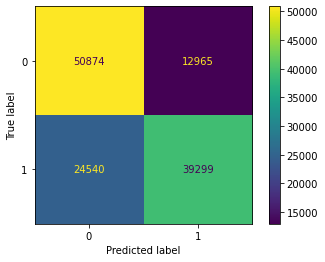

In [68]:
mlp = MLPClassifier(solver='adam', random_state=137, activation='relu', shuffle=False)
mlp.fit(X_train, y_train)
y_pred_mlp = mlp.predict(X_test_sub)
metricas(y_test_sub, y_pred_mlp)


In [69]:
print('Cros validation', cross_val(mlp, X_val, y_val, 8))

d:\Users\rod_e\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:686: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.

d:\Users\rod_e\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:693: UserWarning:

Training interrupted by user.

